# Lab 3 — clustering

In [1]:
import json
import matplotlib.pyplot as plt
import numpy as np
import pickle
from sklearn.cluster import KMeans
import pandas as pd

from operator import itemgetter

%matplotlib inline
plt.style.use("ggplot")

In [2]:
from bokeh.io import show, output_notebook
from bokeh.plotting import figure, ColumnDataSource
from bokeh.models import HoverTool, ResetTool, PanTool, WheelZoomTool, SaveTool
# Categorial colors
from bokeh.palettes import Dark2_8
output_notebook()

Loading BokehJS ...

### Exercise 3.11

Get the movies' coordinates along the five principal directions found in part 1

First, get the movies' coordinates along every exisiting tags

In [3]:
movies = sc.textFile("/ix/ml-20m/movies.txt").map(json.loads)

In [4]:
scores = sc.textFile("/ix/ml-20m/genome-scores.txt").map(json.loads)

In [5]:
tags = sc.textFile("/ix/ml-20m/genome-tags.txt").map(json.loads)

In [6]:
tag2name = dict(tags.map(itemgetter("tagId", "tag")).collect())

In [7]:
mv2name = dict(movies.map(itemgetter("movieId", "title")).collect())

In [8]:
rdd = scores.map(lambda x: x['movieId']).distinct()
mvs = np.array(rdd.collect())
mvs.sort()

In [9]:
sc = scores.map(itemgetter("relevance", "tagId", "movieId")).collect()

In [10]:
def populate(M, sc):
    cur = sc[0][2] # first movie ID
    col = 0 # first col index
    
    for s in sc:
        row = s[1] - 1
        col = col if s[2] == cur else col + 1
        cur = cur if s[2] == cur else s[2]
        M[row][col] = s[0]
    
    return M

In [11]:
M_dim = len(tag2name.values())
N_dim = len(mvs)

In [12]:
M = np.zeros(shape=(M_dim, N_dim))

In [13]:
M = populate(M, sc)

Get every tag's coordinates along the 5 principal directions, which is what we saved from part 1, and create a change-of-basis matrix from it.

In [14]:
# read file
with open("tagscoord.json", "r") as tagscoord:
    data = tagscoord.read()

# parse file
tagscoord = json.loads(data)

In [15]:
cob = np.array(list(tagscoord.values()))

Finally, create the matrix of movies with their coordinates along the five principal directions

In [16]:
X = M.T @ cob

Cluster the data using the k-means clustering algorithm, with k ∈ {2,...,5}.

In [17]:
Ys = {}
for k in range(2, 6):
    Ys[k] = KMeans(n_clusters=k, random_state=0).fit_predict(X)

In [21]:
def plot_k_means(X, Y, dir1, dir2):
    source = ColumnDataSource(
        data={
            "x": [x[dir1] for x in X],
            "y": [x[dir2] for x in X],
            "name": [mv2name[m] for m in mvs],
            "color": [Dark2_8[y] for y in Y],
        })

    hover = HoverTool(
        tooltips=[
            ("Name", "@name"),
        ])
    tools = [hover, ResetTool(), PanTool(), WheelZoomTool(), SaveTool()]

    p = figure(plot_width=960, plot_height=360, tools=tools, title=f"Projection over principal directions {dir1} and {dir2}")
    p.circle("x", "y", source=source, size=5, color="color", alpha=0.5)
    show(p, notebook_handle=True)

In [22]:
for k, Y in Ys.items():
    print(f"With {k} clusters, the plots are the following :")
    for i in range(5):
        for j in range(i+1, 5):
            plot_k_means(X, Y, i, j)

With 2 clusters, the plots are the following :


With 3 clusters, the plots are the following :


With 4 clusters, the plots are the following :


With 5 clusters, the plots are the following :


The first and the second principal direction separate the data the best, whatever the number of clusters used. This makes sense as they are the directions with the most variance so the ones where the data is most separated, which is why the k-means algorithm separates it along these axes first.

### Exercise 3.12

Create a dict that maps movie IDs to set of genres from the data in movies.txt.

In [24]:
mid_to_genres = dict(movies.map(itemgetter("movieId", "genres")).collect())

Implement the k-medioids algorithm with the Jaccard distance.

In [25]:
def k_medioids(X, distance_function, k=2):    
    medioids = np.random.choice(X, size=k, replace=False)
    
    converged = False
    C = [set() for _ in range(k)]
    while not converged:
        C = [set() for _ in range(k)]
        for x in X:
            d = []
            for m in medioids:
                d.append(distance_function(x, m))
            
            C[np.argmin(d)].add(x)
        
        old_medioids = medioids.copy()
        for cluster, m in zip(C, medioids):
            totals = {}
            for x in cluster:
                total = 0
                for y in cluster:
                    total += distance_function(x, y)
                totals[x] = total
            m = min(totals, key=totals.get)
        converged = (medioids == old_medioids).all()
            
    return C

In [26]:
def jaccard_index(x, y):
    set1 = set(mid_to_genres[x])
    set2 = set(mid_to_genres[y])
    return len(set1.intersection(set2)) / len(set1.union(set2))

Cluster the set of movies in the file most-rated.pickle, using k=2.

In [27]:
# Reading an object from disk.
with open("most-rated.pickle", "rb") as f:
    movies = pickle.load(f, encoding="utf-8")
    
movies = [id for id, _ in movies]

Find a good way to visualize the results of the clustering. For example, you could try to visually represent the frequency of the genres in each of the clusters.

In [42]:
def frequency_of_genres(cluster):
    f = {}
    for x in cluster:
        for g in mid_to_genres[x]:
            if g in f:
                f[g] += 1
            else:
                f[g] = 1
    return {k: v / sum(f.values()) for k, v in f.items()}

In [43]:
def plot_genres_frequency(dicts):
    tags = set()
    for d in dicts:
        tags.update(d.keys())
    tags = sorted(tags)
    
    d_values = []
    for d in dicts:
        d_values.append([d.get(k, 0) for k in tags])

    x = np.arange(len(tags))
    width = 0.35

    fig, ax = plt.subplots(figsize=(23,5))
    
    rects = []
    for i, d_value in enumerate(d_values):
        rects.append(ax.bar(x + width * i, d_value, width, label=f"cluster {i}"))

    ax.set_ylabel("Number of movies")
    ax.set_title("Genre frequency in each cluster")
    ax.set_xticks(x)
    ax.set_xticklabels(tags)
    ax.legend()

    fig.tight_layout()

    plt.show()

Run #0


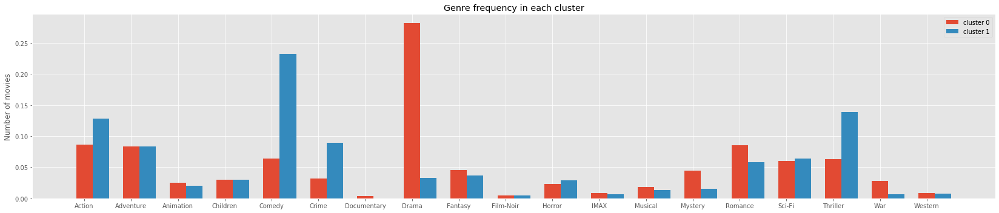

Run #1


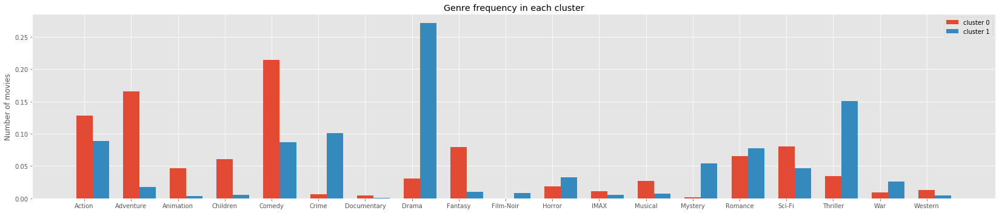

Run #2


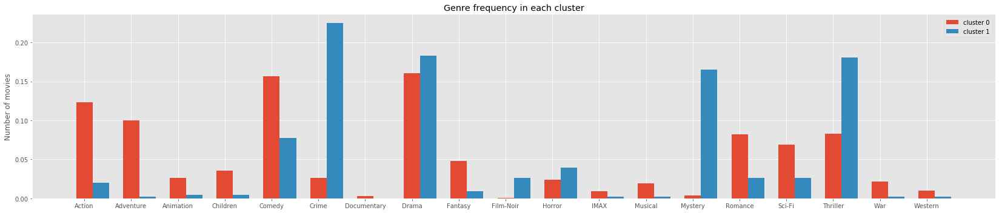

Run #3


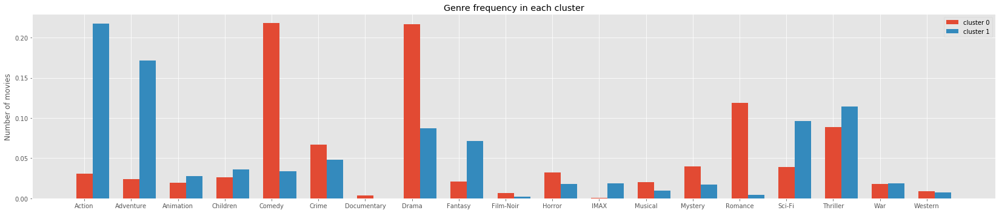

Run #4


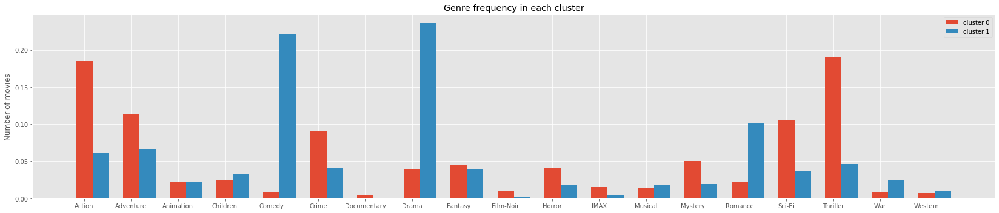

In [49]:
for i in range(5):
    print(f"Run #{i}")
    clusters = k_medioids(movies, jaccard_index)
    plot_genres_frequency([frequency_of_genres(c) for c in clusters])

The two clusters can be interpreted as "serious" (drama, thriller...) vs "light" (comedy, children, adventure, animation...). But sometimes (as for runs #3 and #4) the clusters converge to something else (in this case, "action/adventure" vs "drama/comedy").